# **Public Transport Accessibility to Business Locations such as Bars/Taverns/Pubs**

**Authored by**: Thakoor Madhuvaishali

**Duration:** 150 mins

**Level:** Intermediate

**Pre-requisite Skills:** Python, Data analysis, Data cleaning, Data visualization

Scenario:

As a business owner or city planner, I want to understand the relationship between business locations (such as bars, taverns, and pubs) and public transport accessibility, so that I can make informed decisions about where to establish new businesses or how to improve public transport infrastructure to support existing businesses. By analyzing this relationship, I can identify areas where better transport options could enhance business patronage and growth, ultimately contributing to the economic development of Melbourne.

What this use case will teach you

At the end of this use case, you will:

* Learn how to use Python to analyze and visualize data, enabling you to extract meaningful insights from datasets related to business locations and public transport.
* Gain experience in mapping and geocoding, allowing you to plot business establishment locations on a map and determine their proximity to public transport options.
* Understand how to integrate multiple datasets for analysis, helping you combine information about business locations, bus stops, and tram stops to create a comprehensive and user-friendly tool for analyzing public transport accessibility to business locations.


Introduction:


Public transport accessibility is a crucial factor that can influence the success and growth of businesses. For bars, taverns, and pubs, easy access to public transport can significantly impact customer patronage, especially for those who prefer not to drive. This use case aims to explore the relationship between business locations and public transport accessibility in Melbourne by integrating and analyzing data from the City of Melbourne's Census of Land Use and Employment (CLUE) dataset (2002-2022) along with Bus Stops and Tram Stops datasets. By overlaying business establishment locations with bus and tram stops, this analysis aims to understand how accessibility to these public transport modes impacts business patronage and growth.


**DATASETS LIST:**

*  Bar, tavern, pub patron capacity

https://data.melbourne.vic.gov.au/explore/dataset/bars-and-pubs-with-patron-capacity/information/

This dataset contains information about the locations and industry classifications of business establishments in Melbourne, covering the period from 2002 to 2022. It includes details such as the name, address, and classification (e.g., bars, taverns, pubs) of each business.

* Bus stops

https://data.melbourne.vic.gov.au/explore/dataset/bus-stops/

This dataset contains information about the locations of bus stops in the area, including their geographic coordinates (latitude and longitude). This information is crucial for helping users navigate to their desired support service locations using public transport.

* Tram tracks

https://data.melbourne.vic.gov.au/explore/dataset/tram-tracks/

This dataset contains information about the tram tracks in the area, including their routes and stops. Tram tracks are another important aspect of public transport infrastructure that can help users plan their journeys to support service locations.

# **Importing modules and fetching data from Open Data Melbourne**

In [60]:
#importing all the modules
import requests
import pandas as pd
from io import StringIO
import matplotlib.pyplot as plt
import seaborn as sns
import folium
from folium.plugins import HeatMap
import ipywidgets as widgets
from ipywidgets import interact
from IPython.display import display
import numpy as np


In [62]:
#Loading the bars and pubs dataset
base_url='https://data.melbourne.vic.gov.au/api/explore/v2.1/catalog/datasets/'
dataset_id='bars-and-pubs-with-patron-capacity'

url=f'{base_url}{dataset_id}/exports/csv'
params={'select':'*','limit':-1,'lang':'en','timezone':'UTC'}

response=requests.get(url,params=params)

if response.status_code==200:
    url_content=response.content.decode('utf-8')
    df_business=pd.read_csv(StringIO(url_content),delimiter=';')
    print(df_business.head(10))
else:
    print(f'Request failed with status code {response.status_code}')

   census_year  block_id  property_id  base_property_id  \
0         2002        11       108972            108972   
1         2002        14       103172            103172   
2         2002        15       103944            103944   
3         2002        16       103938            103938   
4         2002        17       103925            103925   
5         2002        33       105937            105937   
6         2002        35       102143            102143   
7         2002        37       102158            102158   
8         2002        42       105392            105392   
9         2002        43       108069            108069   

                               building_address  clue_small_area  \
0           10-22 Spencer Street MELBOURNE 3000  Melbourne (CBD)   
1         31-39 Elizabeth Street MELBOURNE 3000  Melbourne (CBD)   
2          277-279 Flinders Lane MELBOURNE 3000  Melbourne (CBD)   
3              187 Flinders Lane MELBOURNE 3000  Melbourne (CBD)   
4         

In [63]:
#Loading the bus stops dataset
base_url='https://data.melbourne.vic.gov.au/api/explore/v2.1/catalog/datasets/'
dataset_id='bus-stops'


url=f'{base_url}{dataset_id}/exports/csv'
params={'select':'*','limit':-1,'lang':'en','timezone':'UTC'}

response=requests.get(url,params=params)

if response.status_code==200:
    url_content=response.content.decode('utf-8')
    df_bus_stop=pd.read_csv(StringIO(url_content),delimiter=';')
    print(df_bus_stop.head(10))
else:
    print(f'Request failed with status code {response.status_code}')

                              geo_point_2d  \
0   -37.80384165792465, 144.93239283833262   
1    -37.81548699581418, 144.9581794249902   
2   -37.81353897396532, 144.95728334230756   
3   -37.82191394843844, 144.95539345270072   
4   -37.83316401267591, 144.97443745130263   
5   -37.79436108568101, 144.92998424529242   
6  -37.817452093555325, 144.96168480565794   
7    -37.82146476463953, 144.9303191551562   
8  -37.837547087144706, 144.98191138368836   
9  -37.812490976626215, 144.95370614040704   

                                           geo_shape  prop_id  addresspt1  \
0  {"coordinates": [144.93239283833262, -37.80384...        0   76.819824   
1  {"coordinates": [144.9581794249902, -37.815486...        0   21.561304   
2  {"coordinates": [144.95728334230756, -37.81353...        0   42.177187   
3  {"coordinates": [144.95539345270072, -37.82191...        0   15.860434   
4  {"coordinates": [144.97443745130263, -37.83316...        0    0.000000   
5  {"coordinates": [144.9299842

In [64]:
#Loading the tram tracks dataset
base_url='https://data.melbourne.vic.gov.au/api/explore/v2.1/catalog/datasets/'
dataset_id='tram-tracks'


url=f'{base_url}{dataset_id}/exports/csv'
params={'select':'*','limit':-1,'lang':'en','timezone':'UTC'}

response=requests.get(url,params=params)

if response.status_code==200:
    url_content=response.content.decode('utf-8')
    df_tram_tracks=pd.read_csv(StringIO(url_content),delimiter=';')
    print(df_tram_tracks.head(10))
else:
    print(f'Request failed with status code {response.status_code}')

                              geo_point_2d  \
0   -37.78861331868605, 144.93461561782556   
1   -37.819185576253524, 144.9610352542915   
2   -37.81837971233182, 144.95945259116502   
3    -37.81440385390417, 144.9702510191494   
4   -37.816738613153454, 144.9699088149105   
5   -37.83646719875296, 144.98204502621257   
6   -37.82412832636803, 144.97049982199576   
7  -37.797091788559044, 144.96748110523234   
8   -37.79372033756351, 144.95828640079029   
9    -37.8348813636736, 144.97472590308539   

                                           geo_shape  \
0  {"coordinates": [[[[144.934525400489, -37.7886...   
1  {"coordinates": [[[[144.96099441333, -37.81917...   
2  {"coordinates": [[[[144.959343869512, -37.8182...   
3  {"coordinates": [[[[144.969150077924, -37.8147...   
4  {"coordinates": [[[[144.970082905454, -37.8167...   
5  {"coordinates": [[[[144.982231917059, -37.8357...   
6  {"coordinates": [[[[144.970150613164, -37.8234...   
7  {"coordinates": [[[[144.967374842424, -37.

# **Exploratory Analysis**

The section involves the initial steps taken to understand and prepare the dataset for analysis. I have firstly explored the bar,patron, pub dataset and then proceeded to explore the bus stop and tram tracks dataset which were very similarly structured. The df.info() command provides a summary of the dataset, including the number of entries and columns, as well as the data types of each column. This summary helps in assessing the dataset's overall quality and identifying any missing or incorrect data. Finally, cleaning null values from the columns and removing columns that not related to the analysis ensures that the dataset is more concise, less bulky to manipulate and ready for further analysis

**Exploring the bar,pubs and traverns dataset**

In [65]:
# Display a summary of the dataset to check for number of null values
df_business.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4696 entries, 0 to 4695
Data columns (total 12 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   census_year        4696 non-null   int64  
 1   block_id           4696 non-null   int64  
 2   property_id        4696 non-null   int64  
 3   base_property_id   4696 non-null   int64  
 4   building_address   4696 non-null   object 
 5   clue_small_area    4696 non-null   object 
 6   trading_name       4696 non-null   object 
 7   business_address   4696 non-null   object 
 8   number_of_patrons  4696 non-null   int64  
 9   longitude          4676 non-null   float64
 10  latitude           4676 non-null   float64
 11  location           4676 non-null   object 
dtypes: float64(2), int64(5), object(5)
memory usage: 440.4+ KB


In [66]:
# Drop the columns that are not useful for the analysis
df_business = df_business.drop(columns=['location'])
df_business = df_business.drop(columns=['census_year'])
df_business = df_business.drop(columns=['property_id'])
df_business = df_business.drop(columns=['base_property_id'])
df_business = df_business.drop(columns=['number_of_patrons'])

In [67]:
#cleaning the datasets of missing values for latitude,longitude and name as these would be the crucial components for analysis
df_business = df_business.dropna(subset=['latitude', 'longitude', 'trading_name'])

In [68]:
df_business.head(5) # overview of the cleaned dataset

,block_id,building_address,clue_small_area,trading_name,business_address,longitude,latitude
0,11,10-22 Spencer Street MELBOURNE 3000,Melbourne (CBD),Explorers Inn,10-22 Spencer Street MELBOURNE 3000,144.955254,-37.820511
1,14,31-39 Elizabeth Street MELBOURNE 3000,Melbourne (CBD),Connells Tavern,35 Elizabeth Street MELBOURNE 3000,144.964322,-37.817426
2,15,277-279 Flinders Lane MELBOURNE 3000,Melbourne (CBD),De Biers,"Unit 1, Basement , 277 Flinders Lane MELBOURNE...",144.965307,-37.817242
3,16,187 Flinders Lane MELBOURNE 3000,Melbourne (CBD),Adelphi Hotel,187 Flinders Lane MELBOURNE 3000,144.968385,-37.816360
4,17,121-123 Flinders Lane MELBOURNE 3000,Melbourne (CBD),Velour,"Unit 1, Gnd & Bmt , 121 Flinders Lane MELBOURN...",144.970523,-37.815674


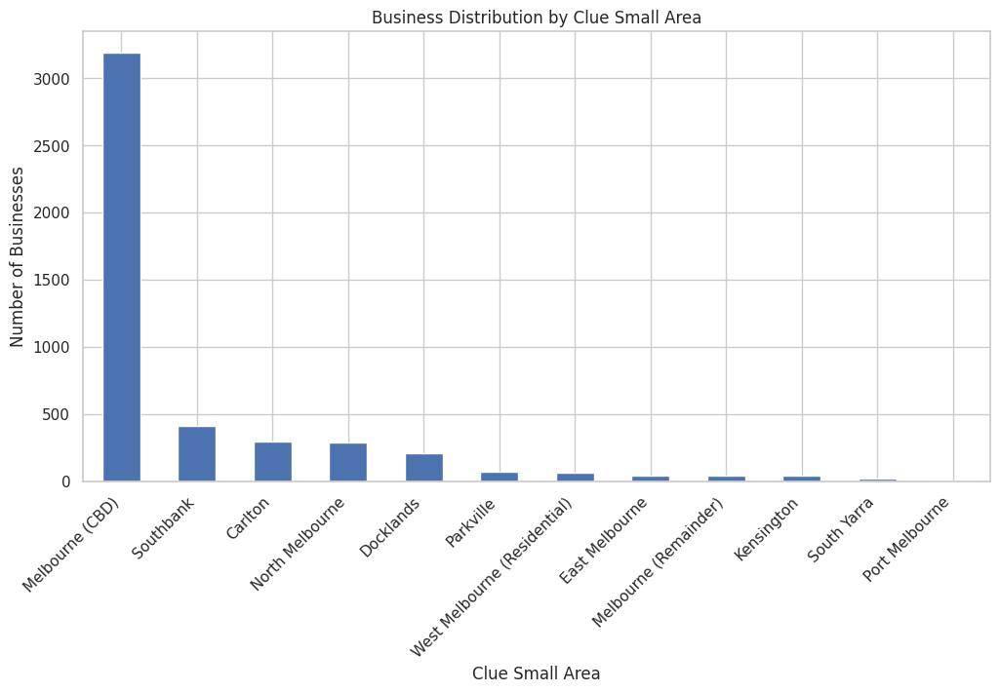

In [70]:
#Plotting Business Distribution by Clue Small Area

import matplotlib.pyplot as plt

plt.figure(figsize=(12, 6))
df_business['clue_small_area'].value_counts().plot(kind='bar')
plt.xlabel('Clue Small Area')
plt.ylabel('Number of Businesses')
plt.title('Business Distribution by Clue Small Area')
_ = plt.xticks(rotation=45, ha='right')


The bar chart shows the number of bars, pubs, and taverns in each CLUE small area. This helps in identifying which areas have a high concentration of businesses and which areas have fewer or no such establishments for example we can see that Melbourne(CBD) has the highest number of businesses.

In [71]:
#Function to filter map based on Clue Small Area
def create_map(clue_area):
    # Filter the DataFrame based on the selected CLUE area
    filtered_df = df_business[df_business['clue_small_area'] == clue_area]

    # Create the map centered on the average location
    map_center = [filtered_df['latitude'].mean(), filtered_df['longitude'].mean()]
    m = folium.Map(location=map_center, zoom_start=13)

    # Add markers for each business location
    for idx, row in filtered_df.iterrows():
        folium.Marker(
            location=[row['latitude'], row['longitude']],
            popup=f"{row['trading_name']}<br>{row['business_address']}",
            tooltip=row['trading_name']
        ).add_to(m)

    # Create a custom legend
    legend_html = '''
    <div style="position: fixed;
                top: 10px; left: 10px;
                width: 150px; height: auto;
                background-color: white;
                border:2px solid grey;
                z-index: 9999;
                padding: 10px;">
    <h4>Legend</h4>
    <i class="fa fa-map-marker" style="color:blue"></i>&nbsp; Business Location<br>
    </div>
    '''

    # Add legend to the map
    m.get_root().html.add_child(folium.Element(legend_html))

    # Display the map
    display(m)


# Get the unique CLUE areas for the dropdown
clue_areas = df_business['clue_small_area'].unique()

# Use ipywidgets to create an interactive dropdown
interact(create_map, clue_area=clue_areas)


interactive(children=(Dropdown(description='clue_area', options=('Melbourne (CBD)', 'Carlton', 'Parkville', 'N…

<function __main__.create_map(clue_area)>

By visualizing the business locations on a map with a dropdown filter based on CLUE small area, the purpose is to allow users (such as city planners or business owners) to interactively explore specific geographic areas and analyze the concentration of businesses in those regions. This filter helps narrow down the map view to individual areas, making it easier to focus on local business distribution and assess public transport accessibility for each area.

**Exploring the bus stop dataset**

In [72]:
# Display a summary of the dataset to check for number of null values
df_bus_stop.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 309 entries, 0 to 308
Data columns (total 16 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   geo_point_2d  309 non-null    object 
 1   geo_shape     309 non-null    object 
 2   prop_id       309 non-null    int64  
 3   addresspt1    309 non-null    float64
 4   addressp_1    309 non-null    int64  
 5   asset_clas    309 non-null    object 
 6   asset_type    309 non-null    object 
 7   objectid      309 non-null    int64  
 8   str_id        309 non-null    int64  
 9   addresspt     309 non-null    int64  
 10  asset_subt    0 non-null      float64
 11  model_desc    309 non-null    object 
 12  mcc_id        309 non-null    int64  
 13  roadseg_id    309 non-null    int64  
 14  descriptio    309 non-null    object 
 15  model_no      309 non-null    object 
dtypes: float64(2), int64(7), object(7)
memory usage: 38.8+ KB


In [73]:
# Ensure the column is of type string
df_bus_stop['geo_point_2d'] = df_bus_stop['geo_point_2d'].astype(str)

# Split 'geo_point_2d' into 'latitude' and 'longitude'
df_bus_stop[['latitude', 'longitude']] = df_bus_stop['geo_point_2d'].str.split(', ', expand=True)

# Convert the new columns to float
df_bus_stop['latitude'] = df_bus_stop['latitude'].astype(float)
df_bus_stop['longitude'] = df_bus_stop['longitude'].astype(float)

In [74]:
# Drop the unrelated columns
df_bus_stop = df_bus_stop[['descriptio', 'model_no', 'model_desc', 'latitude', 'longitude']]

In [75]:
#Display the first few rows of the dataset to get an overview of the data structure and the types of values in each column
df_bus_stop.head(5)

,descriptio,model_no,model_desc,latitude,longitude
0,Sign - Public Transport 1 Panel Bus Stop Type 13,P.16,Sign - Public Transport 1 Panel,-37.803842,144.932393
1,Sign - Public Transport 1 Panel Bus Stop Type 8,P.16,Sign - Public Transport 1 Panel,-37.815487,144.958179
2,Sign - Public Transport 1 Panel Bus Stop Type 8,P.16,Sign - Public Transport 1 Panel,-37.813539,144.957283
3,Sign - Public Transport 1 Panel Bus Stop Type 8,P.16,Sign - Public Transport 1 Panel,-37.821914,144.955393
4,Sign - Public Transport 1 Panel Bus Stop Type 8,P.16,Sign - Public Transport 1 Panel,-37.833164,144.974437


**Exploring the tram tracks dataset**

In [76]:
#Display the first few rows of the dataset to get an overview of the data structure and the types of values in each column
df_tram_tracks.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 645 entries, 0 to 644
Data columns (total 4 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   geo_point_2d  645 non-null    object
 1   geo_shape     645 non-null    object
 2   descriptio    645 non-null    object
 3   name          645 non-null    object
dtypes: object(4)
memory usage: 20.3+ KB


In [77]:
# Ensure the column is of type string
df_tram_tracks['geo_point_2d'] = df_tram_tracks['geo_point_2d'].astype(str)

# Split 'geo_point_2d' into 'latitude' and 'longitude'
df_tram_tracks[['latitude', 'longitude']] = df_tram_tracks['geo_point_2d'].str.split(', ', expand=True)

# Convert the new columns to float
df_tram_tracks['latitude'] = df_tram_tracks['latitude'].astype(float)
df_tram_tracks['longitude'] = df_tram_tracks['longitude'].astype(float)

In [78]:
# Drop the original 'geo_point_2d' and 'geo_shape' and 'deacriptio' columns
#Note that the description column here had data that was in html unredable format which is why it was discarded and only the name was kept
df_tram_tracks = df_tram_tracks.drop(columns=['geo_point_2d'])
df_tram_tracks = df_tram_tracks.drop(columns=['geo_shape'])
df_tram_tracks = df_tram_tracks.drop(columns=['descriptio'])

In [79]:
df_tram_tracks.head(5) #overview of the tram tracks dataset

,name,latitude,longitude
0,kml_3,-37.788613,144.934616
1,kml_5,-37.819186,144.961035
2,kml_6,-37.818380,144.959453
3,kml_7,-37.814404,144.970251
4,kml_8,-37.816739,144.969909


In [80]:
# Create a base map centered on an average location (adjust latitude and longitude for your dataset)
map_center = [df_business['latitude'].mean(), df_business['longitude'].mean()]
m = folium.Map(location=map_center, zoom_start=12)

# Add markers for each business location
for idx, row in df_business.iterrows():
    folium.Marker(
        location=[row['latitude'], row['longitude']],
        popup=f"{row['trading_name']}<br>{row['business_address']}",
        tooltip=row['trading_name'],
        icon=folium.Icon(color='red', icon='info-sign')  # Customize business markers
    ).add_to(m)

# Add markers for bus stops (assuming bus_stops DataFrame has latitude and longitude columns)
for idx, row in df_bus_stop.iterrows():
    folium.Marker(
        location=[row['latitude'], row['longitude']],
        popup=f"Bus Stop: {row['descriptio']}",
        icon=folium.Icon(color='blue', icon='bus')  # Customize bus stop markers
    ).add_to(m)

# Add markers for tram stops (assuming tram_stops DataFrame has latitude and longitude columns)
for idx, row in df_tram_tracks.iterrows():
    folium.Marker(
        location=[row['latitude'], row['longitude']],
        popup=f"Tram Stop: {row['name']}",
        icon=folium.Icon(color='green', icon='train')  # Customize tram stop markers
    ).add_to(m)


# Create a legend using HTML
legend_html = '''
<div style="position: fixed;
     bottom: 30px; left: 30px; width: 120px; height: 100px;
     background-color: white; border:2px solid grey; z-index:9999; font-size:14px;
     ">
     &nbsp; <b>Legend</b> <br>
     &nbsp; <i style="color:red;">&#9679;</i> Business <br>
     &nbsp; <i style="color:blue;">&#9679;</i> Bus Stop <br>
     &nbsp; <i style="color:green;">&#9679;</i> Tram Stop <br>
</div>
'''

# Add the legend to the map
m.get_root().html.add_child(folium.Element(legend_html))

# Display the map
m


The visualisation of this map integrates all available datasets, including the bars, cafes and oubs dataset, bus stops, and tram tracks, to create a comprehensive map showcasing the spatial distribution of these elements. By combining these datasets into a single map, the analysis provides an overview of the entire transportation and support service landscape in the area of interest.



## **Accessibility Analysis of Business Locations Relative to Public Transport**

In this section, we conduct an accessibility analysis of business locations within the city, focusing on their proximity to public transport stops, specifically bus and tram stations.

### **Accesibility Score Analysis:**
By employing the Haversine distance formula, we calculate the distance of each business to its nearest public transport stop. This data is then normalized to derive an accessibility score, which quantifies how easily customers can reach these businesses via public transport. A lower score indicates better accessibility, while a higher score signifies potential challenges in accessing the business. This analysis aims to identify areas with adequate transport access and those lacking it, providing insights that can inform urban planning and business strategies.

In [81]:
from math import radians, sin, cos, sqrt, atan2

# Function to calculate distance between two points
def haversine_distance(lat1, lon1, lat2, lon2):
    # Convert latitude and longitude from degrees to radians
    lat1, lon1, lat2, lon2 = radians(lat1), radians(lon1), radians(lat2), radians(lon2)

    # Haversine formula
    dlat = lat2 - lat1
    dlon = lon2 - lon1
    a = sin(dlat / 2) ** 2 + cos(lat1) * cos(lat2) * sin(dlon / 2) ** 2
    c = 2 * atan2(sqrt(a), sqrt(1 - a))
    r = 6371  # Radius of Earth in kilometers
    distance = r * c

    return distance

# Iterate over each business service and calculate the distance to the nearest bus stop
for index, service_row in df_business.iterrows():
    nearest_distance = float('inf')  # Initialize with a large value
    for stop_index, stop_row in df_bus_stop.iterrows():
        distance = haversine_distance(service_row['latitude'], service_row['longitude'],
                                       stop_row['latitude'], stop_row['longitude'])
        if distance < nearest_distance:
            nearest_distance = distance
    # Update the business location df with the nearest distance to a bus stop
    df_business.at[index, 'nearest_bus_stop_distance'] = nearest_distance

# Iterate over each business service and calculate the distance to the nearest tram stop
for index, service_row in df_business.iterrows():
    nearest_distance = float('inf')  # Initialize with a large value
    for stop_index, stop_row in df_tram_tracks.iterrows():
        distance = haversine_distance(service_row['latitude'], service_row['longitude'],
                                       stop_row['latitude'], stop_row['longitude'])
        if distance < nearest_distance:
            nearest_distance = distance
    # Update the business location df with the nearest distance to a tram
    # stop
    df_business.at[index, 'nearest_tram_track_distance'] = nearest_distance


This code calculates the distance from each support service location to the nearest bus stop and tram track using the Haversine formula to account for the Earth's curvature. It iterates through each business location and calculates the distance to each bus stop and tram track, updating the DataFrame with the nearest distances. This information can be used for mapping and analysis, providing insights into the accessibility of support services via public transport.

In [82]:
# Normalize the nearest bus stop distance
df_business['normalized_bus_stop_distance'] = (df_business['nearest_bus_stop_distance'] - df_business['nearest_bus_stop_distance'].min()) / (df_business['nearest_bus_stop_distance'].max() - df_business['nearest_bus_stop_distance'].min())

# Normalize the nearest tram track distance
df_business['normalized_tram_track_distance'] = (df_business['nearest_tram_track_distance'] - df_business['nearest_tram_track_distance'].min()) / (df_business['nearest_tram_track_distance'].max() - df_business['nearest_tram_track_distance'].min())

# Combine these normalized distances into a single accessibility score
df_business['accessibility_score'] = (df_business['normalized_bus_stop_distance'] + df_business['normalized_tram_track_distance']) / 2


In [83]:
# Create a base map
melbourne_map = folium.Map(location=[-37.8136, 144.9631], zoom_start=12)

# Add business locations to the map
for idx, row in df_business.iterrows():
    folium.CircleMarker(location=[row['latitude'], row['longitude']],
                        radius=5,
                        popup=f"{row['trading_name']}<br>Accessibility Score: {row['accessibility_score']:.2f}",
                        color='blue' if row['accessibility_score'] > 0.5 else 'red',
                        fill=True).add_to(melbourne_map)

# Create a custom legend
legend_html = '''
<div style="position: fixed;
            top: 10px; left: 10px;
            width: 150px; height: auto;
            background-color: white;
            border:2px solid grey;
            z-index: 9999;
            padding: 10px;">
<h4>Legend</h4>
<i style="background: blue; border-radius: 50%; width: 12px; height: 12px; display: inline-block;"></i> Accessibility Score > 0.5<br>
<i style="background: red; border-radius: 50%; width: 12px; height: 12px; display: inline-block;"></i> Accessibility Score ≤ 0.5<br>
</div>
'''

# Add legend to the map
melbourne_map.get_root().html.add_child(folium.Element(legend_html))

# Display the map
melbourne_map



**Explanation of Accessibility Score**

Low Scores (e.g., close to 0): Businesses in areas well-served by public transport, providing easy access for customers, staff, and deliveries.

High Scores (e.g., close to 1): Businesses located in areas with limited public transport access, which may deter customers or make commuting more difficult.

**Interpretation of Accessibility Score Values**

Value of 0.11:

An accessibility score of 0.11 suggests that the business is relatively close to public transport stops. This score implies that either the distance to the nearest bus or tram stop is significantly short, indicating good access to public transport.

Value of 0.54:

An accessibility score of 0.54 indicates that the business is farther from public transport stops. This score suggests that the business may be less accessible, meaning it is relatively far from the nearest bus or tram stop. It may require a longer walk for customers or employees to reach public transport.


### **Average Accessibility Score by Clue Small Area**

In [84]:
# Calculate the average accessibility score by CLUE Small Area
avg_accessibility_by_area = df_business.groupby('clue_small_area')['accessibility_score'].mean().reset_index()

# Sort the results for better visualization
avg_accessibility_by_area = avg_accessibility_by_area.sort_values(by='accessibility_score', ascending=False)

# Print the results
print(avg_accessibility_by_area)


                 clue_small_area  accessibility_score
8                 Port Melbourne             0.485347
2                 East Melbourne             0.326344
1                      Docklands             0.311380
3                     Kensington             0.186127
7                      Parkville             0.185884
10                     Southbank             0.184194
4                Melbourne (CBD)             0.153765
0                        Carlton             0.120954
5          Melbourne (Remainder)             0.108605
11  West Melbourne (Residential)             0.106587
6                North Melbourne             0.083887
9                    South Yarra             0.028589


<ipython-input-85-69e7646fbaad>:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=avg_accessibility_by_area, x='clue_small_area', y='accessibility_score', palette='coolwarm')


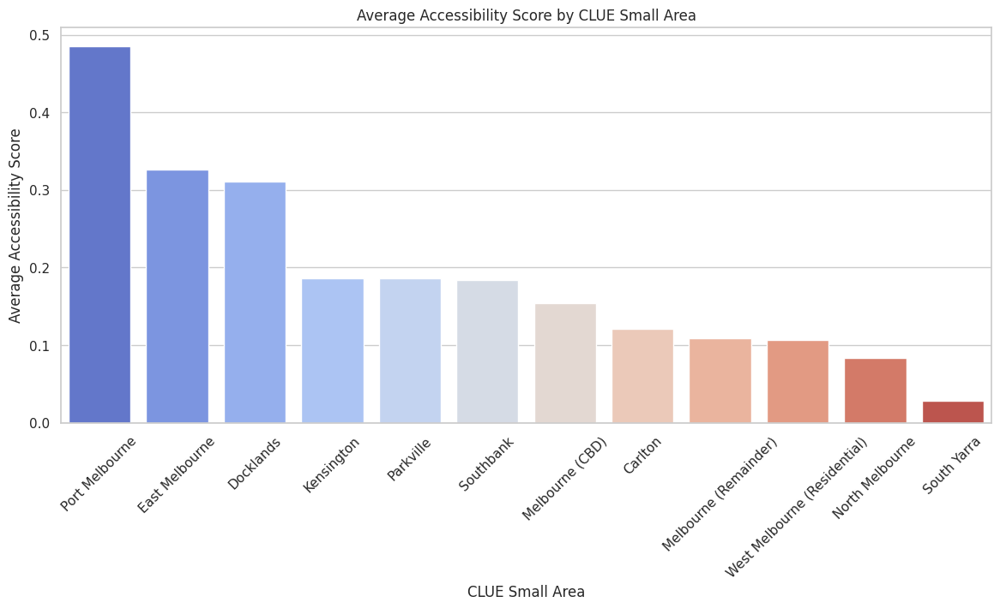

In [85]:
#Plotting accessibility score by clue small area
plt.figure(figsize=(14, 6))
sns.barplot(data=avg_accessibility_by_area, x='clue_small_area', y='accessibility_score', palette='coolwarm')
plt.title('Average Accessibility Score by CLUE Small Area')
plt.xticks(rotation=45)
plt.ylabel('Average Accessibility Score')
plt.xlabel('CLUE Small Area')
plt.show()

**Explanation of results:**

**Top Accessible Areas:**

Port Melbourne (0.485): This area has the highest accessibility score, suggesting it has a robust public transport network and is well-situated for access to bus and tram stops.

East Melbourne (0.326) and Docklands (0.311): Both areas also show good accessibility, likely due to their urban design and proximity to major transport routes.

**Moderately Accessible Areas:**

Kensington (0.186) and Parkville (0.185): These areas have moderate accessibility scores, indicating some level of access to public transport, but there might be room for improvement.

**Lower Accessibility Areas:**

Carlton (0.120) and Melbourne (Remainder) (0.108): These areas show lower scores, which might imply less access to public transport or fewer public transport stops nearby.

**Least Accessible Areas:**

South Yarra (0.028): With the lowest accessibility score in the list, South Yarra may be the least accessible to public transport, suggesting that residents might have to travel farther to reach bus or tram services.

In [86]:
#Plotting an interactive map filtered by clue small area with sccessibility scores of businesses
# Function to create a map with accessibility heatmaps
def create_map_with_heatmap(clue_area):
    # Filter the DataFrame based on the selected CLUE area
    filtered_df = df_business[df_business['clue_small_area'] == clue_area]
    bus_stop_locations = df_bus_stop[['latitude', 'longitude']].values
    tram_stop_locations = df_tram_tracks[['latitude', 'longitude']].values

    # Create the map centered on the average location
    map_center = [filtered_df['latitude'].mean(), filtered_df['longitude'].mean()]
    m = folium.Map(location=map_center, zoom_start=13)

    # Add markers for each business location
    for idx, row in filtered_df.iterrows():
        folium.Marker(
            location=[row['latitude'], row['longitude']],
            popup=f"{row['trading_name']}<br>{row['business_address']}<br>Accessibility Score: {row['accessibility_score']:.2f}",
            tooltip=row['trading_name']
        ).add_to(m)

    # Create a heatmap for business locations
    HeatMap(filtered_df[['latitude', 'longitude']], radius=15).add_to(m)

    # Create a heatmap for bus stops
    HeatMap(bus_stop_locations, radius=15, name='Bus Stops').add_to(m)

    # Create a heatmap for tram stops
    HeatMap(tram_stop_locations, radius=15, name='Tram Stops').add_to(m)

    # Create a heatmap for accessibility scores
    # Normalize accessibility scores for better visualization in the heatmap
    if not filtered_df.empty:
        accessibility_heatmap_data = filtered_df[['latitude', 'longitude', 'accessibility_score']]
        # Normalize accessibility scores to be between 0 and 1 for heatmap
        norm_scores = (accessibility_heatmap_data['accessibility_score'] - accessibility_heatmap_data['accessibility_score'].min()) / \
                      (accessibility_heatmap_data['accessibility_score'].max() - accessibility_heatmap_data['accessibility_score'].min())
        heatmap_data = np.array([accessibility_heatmap_data['latitude'], accessibility_heatmap_data['longitude'], norm_scores]).T
        HeatMap(heatmap_data, radius=20, name='Accessibility Scores').add_to(m)

    # Add a layer control
    folium.LayerControl().add_to(m)

    # Create a custom legend
    legend_html = '''
    <div style="position: fixed;
                top: 10px; left: 10px;
                width: 150px; height: auto;
                background-color: white;
                border:2px solid grey;
                z-index: 9999;
                padding: 10px;">
    <h4>Legend</h4>
    <i class="fa fa-map-marker" style="color:blue"></i>&nbsp; Business Location<br>
    <i style="background-color: red;">&nbsp;&nbsp;&nbsp;</i> Bus Stops<br>
    <i style="background-color: orange;">&nbsp;&nbsp;&nbsp;</i> Tram Stops<br>
    <i style="background-color: green;">&nbsp;&nbsp;&nbsp;</i> Accessibility Score<br>
    </div>
    '''

    # Add legend to the map
    m.get_root().html.add_child(folium.Element(legend_html))

    # Display the map
    display(m)

# Get the unique CLUE areas for the dropdown
clue_areas = df_business['clue_small_area'].unique()

# Use ipywidgets to create an interactive dropdown
interact(create_map_with_heatmap, clue_area=clue_areas)



interactive(children=(Dropdown(description='clue_area', options=('Melbourne (CBD)', 'Carlton', 'Parkville', 'N…

<function __main__.create_map_with_heatmap(clue_area)>

The interactive map above visually represents the accessibility of businesses based on their proximity to public transport, enabling further analysis and insight into public transport accessibility in different areas.

In [87]:
# Count of businesses by CLUE Small Area
business_count_by_area = df_business.groupby('clue_small_area')['trading_name'].count().reset_index()
business_count_by_area = business_count_by_area.rename(columns={'trading_name': 'business_count'})

# Merge with the accessibility scores
area_analysis = pd.merge(avg_accessibility_by_area, business_count_by_area, on='clue_small_area')

# Print the combined results
print(area_analysis)


                 clue_small_area  accessibility_score  business_count
0                 Port Melbourne             0.485347               4
1                 East Melbourne             0.326344              43
2                      Docklands             0.311380             210
3                     Kensington             0.186127              39
4                      Parkville             0.185884              69
5                      Southbank             0.184194             410
6                Melbourne (CBD)             0.153765            3190
7                        Carlton             0.120954             293
8          Melbourne (Remainder)             0.108605              42
9   West Melbourne (Residential)             0.106587              66
10               North Melbourne             0.083887             287
11                   South Yarra             0.028589              23


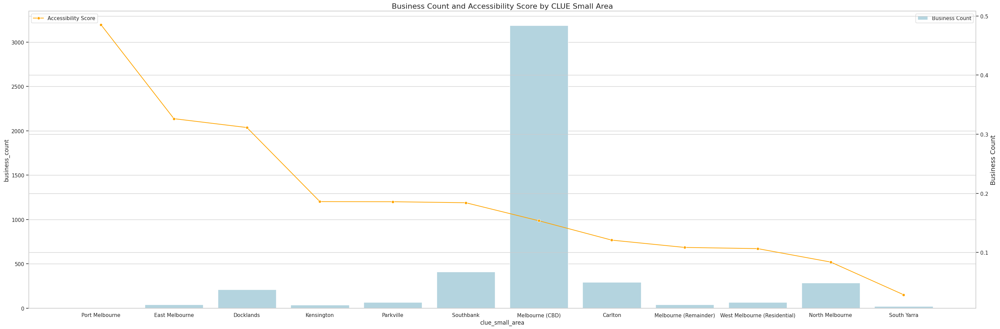

In [108]:
import matplotlib.pyplot as plt
import seaborn as sns

# Create a scatter plot
plt.figure(figsize=(30, 10))

# Create a bar plot for business count
sns.barplot(x='clue_small_area', y='business_count', data=area_analysis, color='lightblue', label='Business Count')

# Create a second y-axis for the accessibility score
plt.twinx()
sns.lineplot(x='clue_small_area', y='accessibility_score', data=area_analysis, color='orange', marker='o', label='Accessibility Score')

# Add titles and labels
plt.title('Business Count and Accessibility Score by CLUE Small Area', fontsize=16)
plt.xlabel('CLUE Small Area', fontsize=12)
plt.ylabel('Business Count', fontsize=14)

# Rotate x-tick labels to 60 degrees for better readability
plt.xticks(rotation=60, ha='right', fontsize=5)

# Optional: Adjust layout to give more space for tick labels
plt.subplots_adjust(bottom=0.2)

# Add legend
plt.legend(loc='upper left')

# Show the plot
plt.tight_layout()
plt.show()


**Explanation:**

Business Count:

Melbourne (CBD) has the highest business count (3190), significantly outnumbering other areas. This indicates a concentration of commercial activity, which may be due to factors like high foot traffic, amenities, and accessibility.

Accessibility Scores:

* Port Melbourne has the highest accessibility score (0.485347) but only has 4 businesses. This suggests that while the area may be well-connected to public transport, it lacks commercial establishments.

* Melbourne (CBD) has a lower accessibility score (0.153765) but an exceptionally high business count (3190). This may indicate that while accessibility is not as high, the sheer volume of businesses compensates for this, or other factors drive business presence in this area.
Trends and Patterns:

* Areas with higher accessibility scores like Port Melbourne and East Melbourne have relatively fewer businesses compared to Southbank and Melbourne (CBD). This suggests that while accessibility is crucial, it may not be the only factor influencing the number of businesses.

* Areas with a lower accessibility score may still have a high business count if they are in strategic locations that attract foot traffic, tourists, or specific demographics.
Potential Outliers:

* Southbank shows a strong balance of accessibility (0.184194) and a high business count (410). This could indicate a successful urban design and transport integration.

* Docklands has a moderate accessibility score (0.311380) but a significant number of businesses (210), showing that it is somewhat well-positioned.

### **Walkability Analysis:**

In this section we are assessing the walkability of the areas surrounding bars and pubs to public transport by checking if the business locations fall within a walkability range of 500ms and the number of businesses closest to bus stops and the number of businesses closest to tram stops.

In [31]:
from math import radians, sin, cos, sqrt, atan2

# Function to calculate the haversine distance between two coordinates
def haversine_distance(lat1, lon1, lat2, lon2):
    # Convert latitude and longitude from degrees to radians
    lat1, lon1, lat2, lon2 = radians(lat1), radians(lon1), radians(lat2), radians(lon2)

    # Haversine formula to calculate the distance
    dlat = lat2 - lat1
    dlon = lon2 - lon1
    a = sin(dlat / 2) ** 2 + cos(lat1) * cos(lat2) * sin(dlon / 2) ** 2
    c = 2 * atan2(sqrt(a), sqrt(1 - a))
    r = 6371  # Radius of the Earth in kilometers
    distance = r * c  # Distance in kilometers
    return distance * 1000  # Convert to meters

# Define the walking distance threshold (500 meters)
walking_distance_threshold = 200

# Create columns to store if a business is within walking distance of a bus or tram stop
df_business['within_200m_bus'] = False
df_business['within_200m_tram'] = False

# Iterate over each business and check proximity to bus stops
for index, business in df_business.iterrows():
    for _, bus_stop in df_bus_stop.iterrows():
        distance = haversine_distance(business['latitude'], business['longitude'],
                                      bus_stop['latitude'], bus_stop['longitude'])
        if distance <= walking_distance_threshold:
            df_business.at[index, 'within_200m_bus'] = True
            break  # No need to check further bus stops for this business

# Iterate over each business and check proximity to tram stops
for index, business in df_business.iterrows():
    for _, tram_stop in df_tram_tracks.iterrows():
        distance = haversine_distance(business['latitude'], business['longitude'],
                                      tram_stop['latitude'], tram_stop['longitude'])
        if distance <= walking_distance_threshold:
            df_business.at[index, 'within_200m_tram'] = True
            break  # No need to check further tram stops for this business

# Now, let's calculate the total number of businesses within 500 meters of any public transport stop
df_business['within_200m_any'] = df_business['within_200m_bus'] | df_business['within_200m_tram']

# Get the count of businesses within walking distance of public transport
within_200m_count = df_business['within_200m_any'].sum()

# Print the results
print(f"Total number of businesses within 200 meters of any public transport stop: {within_200m_count}")
print(f"Businesses near bus stops: {df_business['within_200m_bus'].sum()}")
print(f"Businesses near tram stops: {df_business['within_200m_tram'].sum()}")


Total number of businesses within 200 meters of any public transport stop: 4475
Businesses near bus stops: 2323
Businesses near tram stops: 4142


**Explanation:**

The high total of businesses within 200 meters of public transport indicates a well-connected urban area where access to public transport is not a barrier for customers. This accessibility can lead to increased customer visits, supporting local economies and enhancing business performance.

**Comparative Analysis:**

The higher number of businesses near tram stops compared to bus stops might suggest that tram routes are more strategically placed or that trams are more heavily utilized in this area. It could also indicate a preference among the population for tram travel over buses, which may be due to factors like speed, frequency, or route convenience.

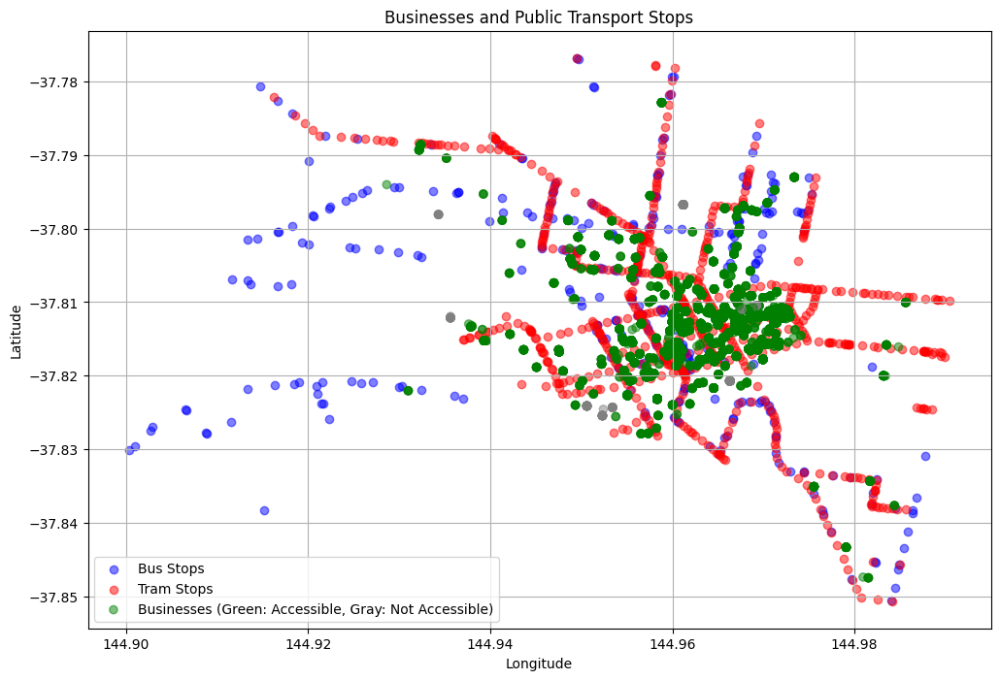

In [29]:
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 8))

# Plot bus stops
plt.scatter(df_bus_stop['longitude'], df_bus_stop['latitude'], color='blue', label='Bus Stops', alpha=0.5)

# Plot tram stops
plt.scatter(df_tram_tracks['longitude'], df_tram_tracks['latitude'], color='red', label='Tram Stops', alpha=0.5)

# Plot businesses and color based on accessibility
plt.scatter(df_business['longitude'], df_business['latitude'],
            color=df_business['within_200m_any'].map({True: 'green', False: 'gray'}),
            label='Businesses (Green: Accessible, Gray: Not Accessible)', alpha=0.5)

plt.title('Businesses and Public Transport Stops')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.legend()
plt.grid()
plt.show()



The scatter plot indicates that most of the businesses are highly accessibile to public transport by walking. We can also see some grey dots indicating just a few that are within the 200m walkability range.  By focusing on both the accessible and less accessible areas, the analysis can drive strategic planning initiatives that ensure equitable access to public transport and support local businesses.

## **Conclusion**
This use case provides a thorough analysis of the relationship between public transport accessibility and the locations of bars, pubs, and taverns in Melbourne. By integrating the datasets, including business locations and public transport stops, we have gained valuable insights into how accessibility influences business patronage in the city.

Key findings from the analysis include:

* **Accessibility Scores**: The calculated accessibility scores reveal areas with varying levels of access to public transport. These insights allow stakeholders to pinpoint underserved neighborhoods that may benefit from enhanced transport options, thereby improving overall accessibility. For instance, areas like Port Melbourne with an accessibility score of 0.485347 demonstrated the highest access to public transport, while regions such as South Yarra had an accessibility score of 0.028589, indicating significant room for improvement.

* **Business Count Analysis**: The analysis also highlighted the count of businesses in relation to accessibility scores. Areas with higher accessibility, such as Melbourne (CBD) with 3,190 businesses, showcased a strong correlation between transport access and business density. This trend illustrates that businesses are more likely to thrive in locations with convenient public transport options, while regions with fewer transport connections tend to have fewer businesses, such as South Yarra, which has only 23 businesses despite being a popular area.

* **Walkability Analysis**: This involved examining whether business locations fall within a 200-meter walkability range from bus and tram stops. The analysis indicates the number of businesses nearest to these public transport options, emphasizing the importance of walkable environments in fostering customer patronage. Businesses within a 200-meter radius of public transport stops were found to be more numerous, reinforcing the idea that accessibility directly impacts customer traffic.

* **Visualization**: The development of interactive maps with the accessibility scores and a filter based on clue small area serves as a clear visual representation of business locations in relation to bus and tram stops. This tool facilitates informed decision-making for urban planners and business owners regarding optimal sites for new establishments.


Recommendations:

Impact on Business Density: The findings indicate a strong correlation between transport access and business density, with areas boasting higher accessibility scores generally housing a greater concentration of bars and pubs. The visual representation on the map, particularly the prevalence of blue zones indicating high accessibility, reinforces this relationship.

Strategic Planning: The insights garnered from this analysis can inform urban planners' decisions regarding public transport service enhancements and potential new business establishments. Additionally, these findings can support local government initiatives aimed at fostering economic development.

In conclusion, this use case serves as a valuable resource for promoting economic growth and ensuring equitable access to public transport across Melbourne. The predominance of areas with high accessibility scores underscores the importance of continued investment in public transport infrastructure to sustain the vitality and expansion of local businesses. By prioritizing accessibility, stakeholders can contribute to a thriving urban environment that benefits both residents and business owners alike.